In [204]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import statsmodels.api as sm

%matplotlib inline

In [205]:
df_in = pd.read_csv('Austin_Animal_Center_Intakes.csv')
df_in.head()

,Animal ID,Name,DateTime,MonthYear,Found Location,Intake Type,Intake Condition,Animal Type,Sex upon Intake,Age upon Intake,Breed,Color
0,A665644,NaN,10/21/2013 07:59:00 AM,October 2013,Austin (TX),Stray,Sick,Cat,Intact Female,4 weeks,Domestic Shorthair Mix,Calico
1,A665739,*Alana,10/22/2013 11:11:00 AM,October 2013,Austin (TX),Stray,Normal,Cat,Intact Female,1 month,Domestic Medium Hair Mix,Black
2,A665763,NaN,10/22/2013 03:10:00 PM,October 2013,E Riverside Dr/Royal Crest Dr in Austin (TX),Stray,Normal,Dog,Intact Male,4 months,Cairn Terrier Mix,Tan/White
3,A379998,Disciple,10/23/2013 11:42:00 AM,October 2013,51St And Grover in Austin (TX),Stray,Normal,Dog,Intact Male,10 years,Pit Bull,Black
4,A634503,Otter,10/01/2013 02:49:00 PM,October 2013,Manor (TX),Owner Surrender,Normal,Dog,Spayed Female,2 years,Norfolk Terrier Mix,Tan


# Preparing the data

In [206]:
df_out = pd.read_csv('Austin_Animal_Center_Outcomes.csv')
df_out.head()

,Animal ID,Name,DateTime,MonthYear,Date of Birth,Outcome Type,Outcome Subtype,Animal Type,Sex upon Outcome,Age upon Outcome,Breed,Color
0,A794011,Chunk,05/08/2019 06:20:00 PM,May 2019,05/02/2017,Rto-Adopt,NaN,Cat,Neutered Male,2 years,Domestic Shorthair Mix,Brown Tabby/White
1,A776359,Gizmo,07/18/2018 04:02:00 PM,Jul 2018,07/12/2017,Adoption,NaN,Dog,Neutered Male,1 year,Chihuahua Shorthair Mix,White/Brown
2,A821648,NaN,08/16/2020 11:38:00 AM,Aug 2020,08/16/2019,Euthanasia,NaN,Other,Unknown,1 year,Raccoon,Gray
3,A720371,Moose,02/13/2016 05:59:00 PM,Feb 2016,10/08/2015,Adoption,NaN,Dog,Neutered Male,4 months,Anatol Shepherd/Labrador Retriever,Buff
4,A674754,NaN,03/18/2014 11:47:00 AM,Mar 2014,03/12/2014,Transfer,Partner,Cat,Intact Male,6 days,Domestic Shorthair Mix,Orange Tabby


In [207]:
df_out = df_out.convert_dtypes(infer_objects=True)
df_out['DateTime'] = pd.to_datetime(df_out['DateTime'])
df_out['Date of Birth'] = pd.to_datetime(df_out['Date of Birth'])
df_out.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 149511 entries, 0 to 149510
Data columns (total 12 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   Animal ID         149511 non-null  string        
 1   Name              106260 non-null  string        
 2   DateTime          149511 non-null  datetime64[ns]
 3   MonthYear         149511 non-null  string        
 4   Date of Birth     149511 non-null  datetime64[ns]
 5   Outcome Type      149485 non-null  string        
 6   Outcome Subtype   68443 non-null   string        
 7   Animal Type       149511 non-null  string        
 8   Sex upon Outcome  149509 non-null  string        
 9   Age upon Outcome  149465 non-null  string        
 10  Breed             149511 non-null  string        
 11  Color             149511 non-null  string        
dtypes: datetime64[ns](2), string(10)
memory usage: 13.7 MB


## Colors

In [208]:
from math import pi

# colors.csv was compiled from these wikipedia articles
# https://en.wikipedia.org/wiki/List_of_colors:_A–F
# https://en.wikipedia.org/wiki/List_of_colors:_G%E2%80%93M
# https://en.wikipedia.org/wiki/List_of_colors:_N%E2%80%93Z
# Then the "—" character was replaced with "0"
df_colors = pd.read_csv('colors.csv')
df_colors = df_colors.convert_dtypes(infer_objects=True)
df_colors['Name'] = df_colors['Name'].str.lower()
df_colors['Red (RGB)'] = pd.to_numeric(df_colors['Red (RGB)'].str.replace('%', '')).div(100)
df_colors['Green (RGB)'] = pd.to_numeric(df_colors['Green (RGB)'].str.replace('%', '')).div(100)
df_colors['Blue (RGB)'] = pd.to_numeric(df_colors['Blue (RGB)'].str.replace('%', '')).div(100)
df_colors['Hue (HSL/HSV)'] = pd.to_numeric(df_colors['Hue (HSL/HSV)'].str.replace('°', '')).div(360)
df_colors['Satur. (HSL)'] = pd.to_numeric(df_colors['Satur. (HSL)'].str.replace('%', '')).div(100)
df_colors['Light (HSL)'] = pd.to_numeric(df_colors['Light (HSL)'].str.replace('%', '')).div(100)
df_colors['Satur. (HSV)'] = pd.to_numeric(df_colors['Satur. (HSV)'].str.replace('%', '')).div(100)
df_colors['Value (HSV)'] = pd.to_numeric(df_colors['Value (HSV)'].str.replace('%', '')).div(100)
df_colors.head()

,Name,Hex (RGB),Red (RGB),Green (RGB),Blue (RGB),Hue (HSL/HSV),Satur. (HSL),Light (HSL),Satur. (HSV),Value (HSV),Source
0,absolute zero,#0048BA,0.00,0.28,0.73,0.602778,1.00,0.37,1.00,0.73,Crayola
1,acid green,#B0BF1A,0.69,0.75,0.10,0.180556,0.76,0.43,0.76,0.43,Art Paints YG07S
2,aero,#7CB9E8,0.49,0.73,0.91,0.572222,0.70,0.70,0.47,0.91,Maerz and Paul
3,african violet,#B284BE,0.70,0.52,0.75,0.800000,0.31,0.63,0.31,0.75,Pantone
4,air superiority blue,#72A0C1,0.45,0.63,0.76,0.569444,0.39,0.60,0.41,0.76,Federal Standard 595


Since we will look for correlations with the color variables for the animals, we want to account for the fact that those color variables are drawn from this dataset, and so there could be a sampling bias in how the colors are interpreted.

Here, it looks like there is a weak correlation between red and green and between green and blue, but red and blue are mostly unrelated.

/tmp/ipykernel_7592/3282312412.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(data=df_colors.corr(), annot=True)


<AxesSubplot:>

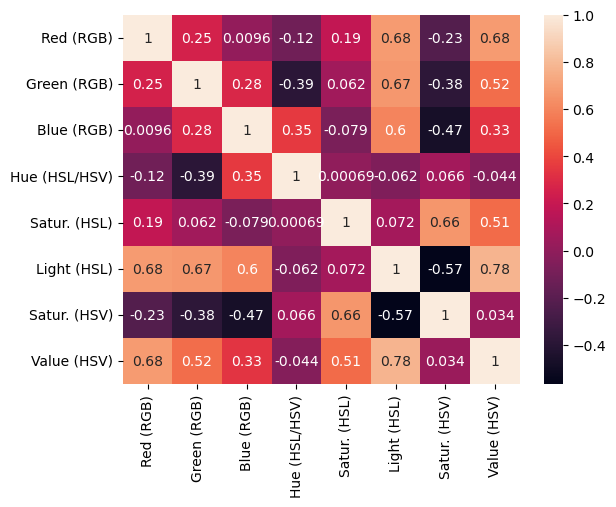

In [209]:
sns.heatmap(data=df_colors.corr(), annot=True)

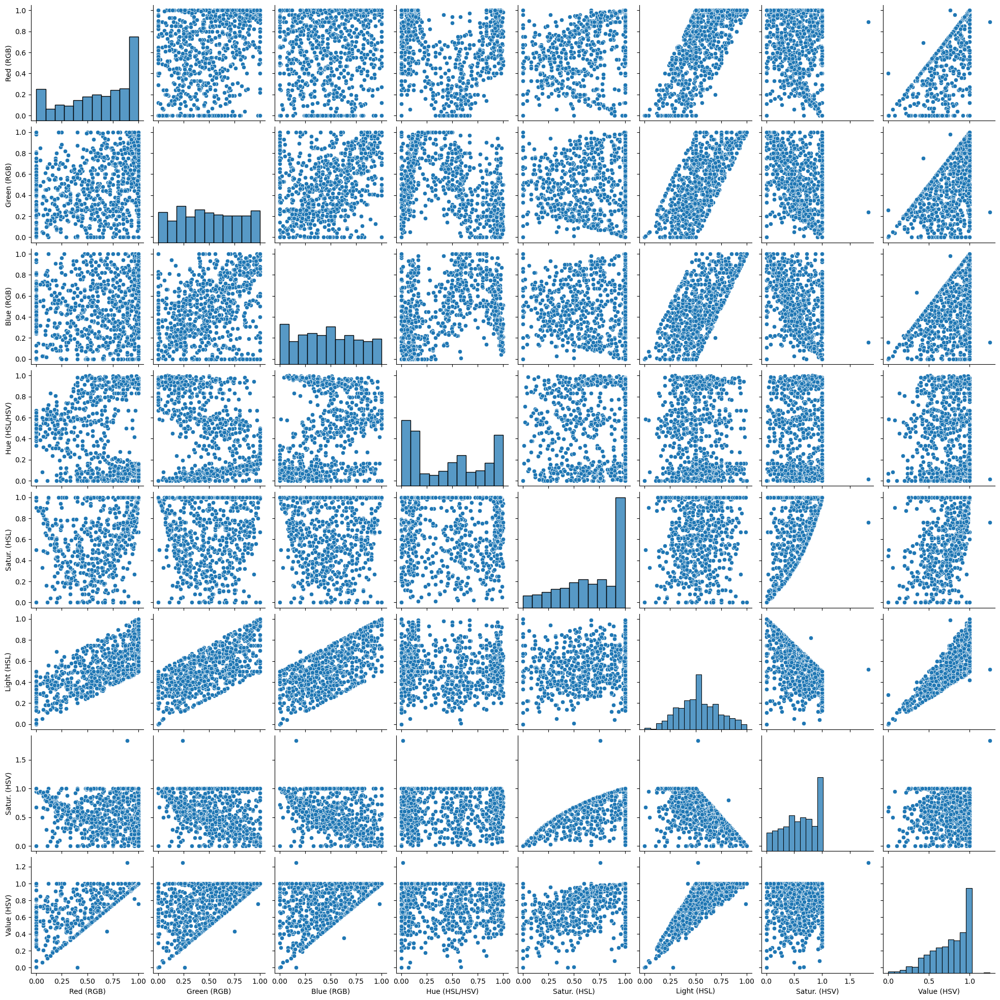

In [210]:
sns.pairplot(df_colors)

Colors are looked up by splitting the query color name by words, then looking for the first exact match with one of the words, but if there are none then it looks for any color with a name containing any of the query words.

For example, consider looking up colors with the word "brown" in their name. Notice that none of the colors are literally "brown" though they all have "brown" in the name.

In [211]:
df_colors.loc[df_colors.Name.str.contains("brown")]

,Name,Hex (RGB),Red (RGB),Green (RGB),Blue (RGB),Hue (HSL/HSV),Satur. (HSL),Light (HSL),Satur. (HSV),Value (HSV),Source
47,bistre brown,#967117,0.59,0.44,0.09,0.119444,0.73,0.34,0.85,0.59,ISCC-NBS
79,brown sugar,#AF6E4D,0.69,0.43,0.30,0.055556,0.39,0.49,0.56,0.69,Crayola
84,burnished brown,#A17A74,0.63,0.48,0.45,0.022222,0.19,0.54,0.28,0.63,Crayola
157,coyote brown,#81613C,0.51,0.38,0.24,0.088889,0.37,0.37,0.52,0.51,colorcode.is
168,dark brown,#654321,0.40,0.26,0.13,0.083333,0.51,0.26,0.67,0.40,X11/Web
209,drab dark brown,#4A412A,0.29,0.25,0.16,0.119444,0.28,0.23,0.43,0.29,Pantone
271,golden brown,#996515,0.60,0.40,0.08,0.100000,0.76,0.34,0.86,0.60,<NA>
596,pullman brown (ups brown),#644117,0.39,0.25,0.09,0.091667,0.63,0.24,0.77,0.39,<NA>
661,rosy brown,#BC8F8F,0.74,0.56,0.56,0.000000,0.25,0.65,0.24,0.74,<NA>
677,saddle brown,#8B4513,0.55,0.27,0.07,0.069444,0.76,0.31,0.86,0.55,<NA>


In [212]:
def colorInfo(color):
    color = color.lower()
    words = [color] if color.count(' ') == 0 else [color] + color.split(' ')
    for word in words:
        try:
            items = df_colors.loc[df_colors.Name == word]
            if len(items) > 0:
                return items
        except:
            continue
    
    for word in words:
        try:
            items = df_colors.loc[df_colors.Name.str.contains(word)]
            if len(items) > 0:
                return items
        except:
            continue
        
    return None

# def rgb(color):
#     info = colorInfo(color)
#     if info is None: return (None, None, None)
#     r = info['Red (RGB)'].values[0]
#     g = info['Green (RGB)'].values[0]
#     b = info['Blue (RGB)'].values[0]
#     return (r, g, b)

def rgbhsv(color):
    info = colorInfo(color)
    if info is None: return (None, None, None, None, None, None)
    r = info['Red (RGB)'].values[0]
    g = info['Green (RGB)'].values[0]
    b = info['Blue (RGB)'].values[0]
    h = info['Hue (HSL/HSV)'].values[0]
    s = info['Satur. (HSV)'].values[0]
    v = info['Value (HSV)'].values[0]
    return (r, g, b, h, s, v)

rgbhsv('brown')

(0.59, 0.44, 0.09, 0.11944444444444445, 0.85, 0.59)

In [213]:
def flatten(x):
    res = []
    for y in x:
        res.extend(y)
    return res

flatten([(1, 2), ('x', 'y')])

[1, 2, 'x', 'y']

In [214]:
def twoColors(colors):
    return colors if len(colors) == 2 else [colors[0], colors[0]]

df_out['Colors (count)'] = df_out.Color.str.count('/') + 1
df_out = df_out.assign(**{
    'Color 0': [twoColors(colors)[0] for colors in df_out.Color.str.split('/')],
    'Color 1': [twoColors(colors)[1] for colors in df_out.Color.str.split('/')]
}).convert_dtypes(infer_objects=True)
df_out.info()
df_out.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 149511 entries, 0 to 149510
Data columns (total 15 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   Animal ID         149511 non-null  string        
 1   Name              106260 non-null  string        
 2   DateTime          149511 non-null  datetime64[ns]
 3   MonthYear         149511 non-null  string        
 4   Date of Birth     149511 non-null  datetime64[ns]
 5   Outcome Type      149485 non-null  string        
 6   Outcome Subtype   68443 non-null   string        
 7   Animal Type       149511 non-null  string        
 8   Sex upon Outcome  149509 non-null  string        
 9   Age upon Outcome  149465 non-null  string        
 10  Breed             149511 non-null  string        
 11  Color             149511 non-null  string        
 12  Colors (count)    149511 non-null  Int64         
 13  Color 0           149511 non-null  string        
 14  Colo

,Animal ID,Name,DateTime,MonthYear,Date of Birth,Outcome Type,Outcome Subtype,Animal Type,Sex upon Outcome,Age upon Outcome,Breed,Color,Colors (count),Color 0,Color 1
0,A794011,Chunk,2019-05-08 18:20:00,May 2019,2017-05-02,Rto-Adopt,<NA>,Cat,Neutered Male,2 years,Domestic Shorthair Mix,Brown Tabby/White,2,Brown Tabby,White
1,A776359,Gizmo,2018-07-18 16:02:00,Jul 2018,2017-07-12,Adoption,<NA>,Dog,Neutered Male,1 year,Chihuahua Shorthair Mix,White/Brown,2,White,Brown
2,A821648,<NA>,2020-08-16 11:38:00,Aug 2020,2019-08-16,Euthanasia,<NA>,Other,Unknown,1 year,Raccoon,Gray,1,Gray,Gray
3,A720371,Moose,2016-02-13 17:59:00,Feb 2016,2015-10-08,Adoption,<NA>,Dog,Neutered Male,4 months,Anatol Shepherd/Labrador Retriever,Buff,1,Buff,Buff
4,A674754,<NA>,2014-03-18 11:47:00,Mar 2014,2014-03-12,Transfer,Partner,Cat,Intact Male,6 days,Domestic Shorthair Mix,Orange Tabby,1,Orange Tabby,Orange Tabby


This cell takes several minutes to complete

In [215]:
colorsRGBHSV = [flatten([rgbhsv(color) for color in twoColors(colors)]) for colors in df_out.Color.str.split('/')]
df_out = df_out.assign(**{
    'Color 0 R': [colorRGBHSV[0] for colorRGBHSV in colorsRGBHSV],
    'Color 0 G': [colorRGBHSV[1] for colorRGBHSV in colorsRGBHSV],
    'Color 0 B': [colorRGBHSV[2] for colorRGBHSV in colorsRGBHSV],
    'Color 0 H': [colorRGBHSV[3] for colorRGBHSV in colorsRGBHSV],
    'Color 0 S': [colorRGBHSV[4] for colorRGBHSV in colorsRGBHSV],
    'Color 0 V': [colorRGBHSV[5] for colorRGBHSV in colorsRGBHSV],
    'Color 1 R': [colorRGBHSV[6 + 0] for colorRGBHSV in colorsRGBHSV],
    'Color 1 G': [colorRGBHSV[6 + 1] for colorRGBHSV in colorsRGBHSV],
    'Color 1 B': [colorRGBHSV[6 + 2] for colorRGBHSV in colorsRGBHSV],
    'Color 1 H': [colorRGBHSV[6 + 3] for colorRGBHSV in colorsRGBHSV],
    'Color 1 S': [colorRGBHSV[6 + 4] for colorRGBHSV in colorsRGBHSV],
    'Color 1 V': [colorRGBHSV[6 + 5] for colorRGBHSV in colorsRGBHSV],
})
df_out

,Animal ID,Name,DateTime,MonthYear,Date of Birth,Outcome Type,Outcome Subtype,Animal Type,Sex upon Outcome,Age upon Outcome,...,Color 0 B,Color 0 H,Color 0 S,Color 0 V,Color 1 R,Color 1 G,Color 1 B,Color 1 H,Color 1 S,Color 1 V
0,A794011,Chunk,2019-05-08 18:20:00,May 2019,2017-05-02,Rto-Adopt,<NA>,Cat,Neutered Male,2 years,...,0.09,0.119444,0.85,0.59,1.00,1.00,1.00,0.000000,0.00,1.00
1,A776359,Gizmo,2018-07-18 16:02:00,Jul 2018,2017-07-12,Adoption,<NA>,Dog,Neutered Male,1 year,...,1.00,0.000000,0.00,1.00,0.59,0.44,0.09,0.119444,0.85,0.59
2,A821648,<NA>,2020-08-16 11:38:00,Aug 2020,2019-08-16,Euthanasia,<NA>,Other,Unknown,1 year,...,0.71,0.375000,0.06,0.75,0.70,0.75,0.71,0.375000,0.06,0.75
3,A720371,Moose,2016-02-13 17:59:00,Feb 2016,2015-10-08,Adoption,<NA>,Dog,Neutered Male,4 months,...,0.50,0.091667,0.50,1.00,1.00,0.78,0.50,0.091667,0.50,1.00
4,A674754,<NA>,2014-03-18 11:47:00,Mar 2014,2014-03-12,Transfer,Partner,Cat,Intact Male,6 days,...,0.00,0.083333,1.00,1.00,1.00,0.50,0.00,0.083333,1.00,1.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149506,A859974,*Lady Gaga,2022-08-16 11:42:00,Aug 2022,2012-06-21,Adoption,<NA>,Cat,Spayed Female,10 years,...,1.00,0.000000,0.00,1.00,1.00,1.00,1.00,0.000000,0.00,1.00
149507,A856973,*Suede,2022-06-11 15:39:00,Jun 2022,2021-05-10,Adoption,<NA>,Cat,Spayed Female,1 year,...,1.00,0.666667,1.00,1.00,0.00,0.00,1.00,0.666667,1.00,1.00
149508,A852036,Queen,2022-03-17 17:22:00,Mar 2022,2021-12-08,Adoption,<NA>,Dog,Spayed Female,3 months,...,0.09,0.119444,0.85,0.59,0.00,0.00,0.00,0.000000,0.00,0.00
149509,A852775,A852775,2022-05-18 14:13:00,May 2022,2022-01-31,Adoption,Foster,Cat,Spayed Female,3 months,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Age

The "Age Upon Outcome (years)" column is made here

In [216]:
def age_years(age):
    try:
        [number_str, unit] = age.split(' ')
        number = float(number_str)
        if unit in ['years', 'year']:
            return number
        elif unit in ['months', 'month']:
            return number / 12
        elif unit in ['weeks', 'week']:
            return number / 52
        elif unit in ['days', 'day']:
            return number / 365
    except: pass
    return None

df_out['Age upon Outcome (years)'] = [age_years(age) for age in df_out['Age upon Outcome']]
df_out.head()

,Animal ID,Name,DateTime,MonthYear,Date of Birth,Outcome Type,Outcome Subtype,Animal Type,Sex upon Outcome,Age upon Outcome,...,Color 0 H,Color 0 S,Color 0 V,Color 1 R,Color 1 G,Color 1 B,Color 1 H,Color 1 S,Color 1 V,Age upon Outcome (years)
0,A794011,Chunk,2019-05-08 18:20:00,May 2019,2017-05-02,Rto-Adopt,<NA>,Cat,Neutered Male,2 years,...,0.119444,0.85,0.59,1.00,1.00,1.00,0.000000,0.00,1.00,2.000000
1,A776359,Gizmo,2018-07-18 16:02:00,Jul 2018,2017-07-12,Adoption,<NA>,Dog,Neutered Male,1 year,...,0.000000,0.00,1.00,0.59,0.44,0.09,0.119444,0.85,0.59,1.000000
2,A821648,<NA>,2020-08-16 11:38:00,Aug 2020,2019-08-16,Euthanasia,<NA>,Other,Unknown,1 year,...,0.375000,0.06,0.75,0.70,0.75,0.71,0.375000,0.06,0.75,1.000000
3,A720371,Moose,2016-02-13 17:59:00,Feb 2016,2015-10-08,Adoption,<NA>,Dog,Neutered Male,4 months,...,0.091667,0.50,1.00,1.00,0.78,0.50,0.091667,0.50,1.00,0.333333
4,A674754,<NA>,2014-03-18 11:47:00,Mar 2014,2014-03-12,Transfer,Partner,Cat,Intact Male,6 days,...,0.083333,1.00,1.00,1.00,0.50,0.00,0.083333,1.00,1.00,0.016438


## Sex

Male or female are classified in two columns since some animals are of unknown sex

In [217]:
# sex and neuter/spay columns

sex_male = df_out['Sex upon Outcome'].str.endswith(' Male')
sex_female = df_out['Sex upon Outcome'].str.endswith(' Female')
neutered_or_spayed = df_out['Sex upon Outcome'].str.startswith('Neutered') | df_out['Sex upon Outcome'].str.startswith('Spayed')

df_out['Male'] = sex_male
df_out['Female'] = sex_female
df_out['NeuteredOrSpayed'] = neutered_or_spayed
df_out = df_out.convert_dtypes(convert_boolean=True)
df_out.info()
df_out.head(10)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 149511 entries, 0 to 149510
Data columns (total 31 columns):
 #   Column                    Non-Null Count   Dtype         
---  ------                    --------------   -----         
 0   Animal ID                 149511 non-null  string        
 1   Name                      106260 non-null  string        
 2   DateTime                  149511 non-null  datetime64[ns]
 3   MonthYear                 149511 non-null  string        
 4   Date of Birth             149511 non-null  datetime64[ns]
 5   Outcome Type              149485 non-null  string        
 6   Outcome Subtype           68443 non-null   string        
 7   Animal Type               149511 non-null  string        
 8   Sex upon Outcome          149509 non-null  string        
 9   Age upon Outcome          149465 non-null  string        
 10  Breed                     149511 non-null  string        
 11  Color                     149511 non-null  string        
 12  Co

,Animal ID,Name,DateTime,MonthYear,Date of Birth,Outcome Type,Outcome Subtype,Animal Type,Sex upon Outcome,Age upon Outcome,...,Color 1 R,Color 1 G,Color 1 B,Color 1 H,Color 1 S,Color 1 V,Age upon Outcome (years),Male,Female,NeuteredOrSpayed
0,A794011,Chunk,2019-05-08 18:20:00,May 2019,2017-05-02,Rto-Adopt,<NA>,Cat,Neutered Male,2 years,...,1.0,1.0,1.0,0.0,0.0,1.0,2.0,True,False,True
1,A776359,Gizmo,2018-07-18 16:02:00,Jul 2018,2017-07-12,Adoption,<NA>,Dog,Neutered Male,1 year,...,0.59,0.44,0.09,0.119444,0.85,0.59,1.0,True,False,True
2,A821648,<NA>,2020-08-16 11:38:00,Aug 2020,2019-08-16,Euthanasia,<NA>,Other,Unknown,1 year,...,0.7,0.75,0.71,0.375,0.06,0.75,1.0,False,False,False
3,A720371,Moose,2016-02-13 17:59:00,Feb 2016,2015-10-08,Adoption,<NA>,Dog,Neutered Male,4 months,...,1.0,0.78,0.5,0.091667,0.5,1.0,0.333333,True,False,True
4,A674754,<NA>,2014-03-18 11:47:00,Mar 2014,2014-03-12,Transfer,Partner,Cat,Intact Male,6 days,...,1.0,0.5,0.0,0.083333,1.0,1.0,0.016438,True,False,False
5,A659412,Princess,2020-10-05 14:37:00,Oct 2020,2013-03-24,Adoption,<NA>,Dog,Spayed Female,7 years,...,0.59,0.44,0.09,0.119444,0.85,0.59,7.0,False,True,True
6,A814515,Quentin,2020-05-06 07:59:00,May 2020,2018-03-01,Adoption,Foster,Dog,Neutered Male,2 years,...,0.59,0.44,0.09,0.119444,0.85,0.59,2.0,True,False,True
7,A868405,*Leo,2023-03-04 13:38:00,Mar 2023,2020-11-02,Adoption,<NA>,Dog,Neutered Male,2 years,...,1.0,1.0,1.0,0.0,0.0,1.0,2.0,True,False,True
8,A689724,*Donatello,2014-10-18 18:52:00,Oct 2014,2014-08-01,Adoption,<NA>,Cat,Neutered Male,2 months,...,0.0,0.0,0.0,0.0,0.0,0.0,0.166667,True,False,True
9,A680969,*Zeus,2014-08-05 16:59:00,Aug 2014,2014-06-03,Adoption,<NA>,Cat,Neutered Male,2 months,...,1.0,0.5,0.0,0.083333,1.0,1.0,0.166667,True,False,True


## Adopted?

In [218]:
df_out['Adopted'] = df_out['Outcome Type'].str.find('Adopt') >= 0

In [219]:
def bigCorr_categorical(df, independent, dependent):
    return (
        df[[independent, dependent]].groupby(independent).value_counts().div(
        df[[independent]].groupby(independent).value_counts())
    )[:,True]

# Analysis by breed

In [220]:
df_breeds = pd.DataFrame(index=df_out.Breed.unique())
df_breeds

""
Domestic Shorthair Mix
Chihuahua Shorthair Mix
Raccoon
Anatol Shepherd/Labrador Retriever
American Foxhound/Labrador Retriever
...
Pointer/Alaskan Husky
Harrier/Anatol Shepherd
German Shepherd/Dachshund
Pointer/Smooth Fox Terrier


In [221]:
# Add animal type to the breed

breeds = [breed_type[0] for breed_type in df_out[['Breed', 'Animal Type']].groupby('Breed').value_counts().index]
types = [breed_type[1] for breed_type in df_out[['Breed', 'Animal Type']].groupby('Breed').value_counts().index]
df_breeds_types = pd.DataFrame(data=types, index=breeds, columns=['Type'])
df_breeds_types = df_breeds_types.assign(Breed=breeds)
df_breeds_types = df_breeds_types.drop_duplicates('Breed')
df_breeds = df_breeds.assign(**{'Animal Type': df_breeds_types['Type']})
df_breeds = df_breeds.convert_dtypes(infer_objects=True)
df_breeds

,Animal Type
Domestic Shorthair Mix,Cat
Chihuahua Shorthair Mix,Dog
Raccoon,Other
Anatol Shepherd/Labrador Retriever,Dog
American Foxhound/Labrador Retriever,Dog
...,...
Pointer/Alaskan Husky,Dog
Harrier/Anatol Shepherd,Dog
German Shepherd/Dachshund,Dog
Pointer/Smooth Fox Terrier,Dog


In [222]:
## Adoption likelihood

df_breeds = df_breeds.assign(Adopted=bigCorr_categorical(df_out, 'Breed', 'Adopted'))
df_breeds

,Animal Type,Adopted
Domestic Shorthair Mix,Cat,0.461425
Chihuahua Shorthair Mix,Dog,0.483181
Raccoon,Other,NaN
Anatol Shepherd/Labrador Retriever,Dog,0.583333
American Foxhound/Labrador Retriever,Dog,1.000000
...,...,...
Pointer/Alaskan Husky,Dog,1.000000
Harrier/Anatol Shepherd,Dog,1.000000
German Shepherd/Dachshund,Dog,1.000000
Pointer/Smooth Fox Terrier,Dog,NaN


In [223]:
def means(df_groups, df_individual, independent, dependent):
    df_groups[f'{dependent} (mean)'] = df_individual[[independent, dependent]].groupby(independent).mean()
def stdDevs(df_groups, df_individual, independent, dependent):
    df_groups[f'{dependent} (std dev)'] = df_individual[[independent, dependent]].groupby(independent).std()
def stats(df_groups, df_individual, independent, dependent):
    means(df_groups, df_individual, independent, dependent)
    stdDevs(df_groups, df_individual, independent, dependent)

for color_index in ['0', '1']:
    for color_feature in ['R', 'G', 'B', 'H', 'S', 'V']:
        stats(df_breeds, df_out, 'Breed', f'Color {color_index} {color_feature}')

df_breeds.head()

,Animal Type,Adopted,Color 0 R (mean),Color 0 R (std dev),Color 0 G (mean),Color 0 G (std dev),Color 0 B (mean),Color 0 B (std dev),Color 0 H (mean),Color 0 H (std dev),...,Color 1 G (mean),Color 1 G (std dev),Color 1 B (mean),Color 1 B (std dev),Color 1 H (mean),Color 1 H (std dev),Color 1 S (mean),Color 1 S (std dev),Color 1 V (mean),Color 1 V (std dev)
Domestic Shorthair Mix,Cat,0.461425,0.439476,0.412274,0.322711,0.323957,0.286948,0.413041,0.157459,0.221864,...,0.533746,0.410991,0.50789,0.474873,0.110554,0.198967,0.385803,0.453537,0.718904,0.385966
Chihuahua Shorthair Mix,Dog,0.483181,0.609789,0.370759,0.493648,0.361854,0.356013,0.369441,0.060187,0.076624,...,0.668548,0.335132,0.543445,0.394424,0.052054,0.064261,0.310403,0.347427,0.763876,0.302056
Raccoon,Other,NaN,0.437671,0.310867,0.413988,0.316846,0.298782,0.327126,0.177938,0.162433,...,0.361811,0.369510,0.303607,0.363179,0.141413,0.170804,0.128858,0.277666,0.380989,0.376901
Anatol Shepherd/Labrador Retriever,Dog,0.583333,0.763611,0.260660,0.672222,0.288811,0.464722,0.396827,0.071142,0.055755,...,0.676857,0.404895,0.608571,0.421518,0.028492,0.045675,0.138857,0.239850,0.717143,0.410535
American Foxhound/Labrador Retriever,Dog,1.000000,1.0,0.000000,1.0,0.000000,1.0,0.000000,0.0,0.000000,...,0.44,0.000000,0.09,0.000000,0.119444,0.000000,0.85,0.000000,0.59,0.000000


/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(widths, name="widths"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not in

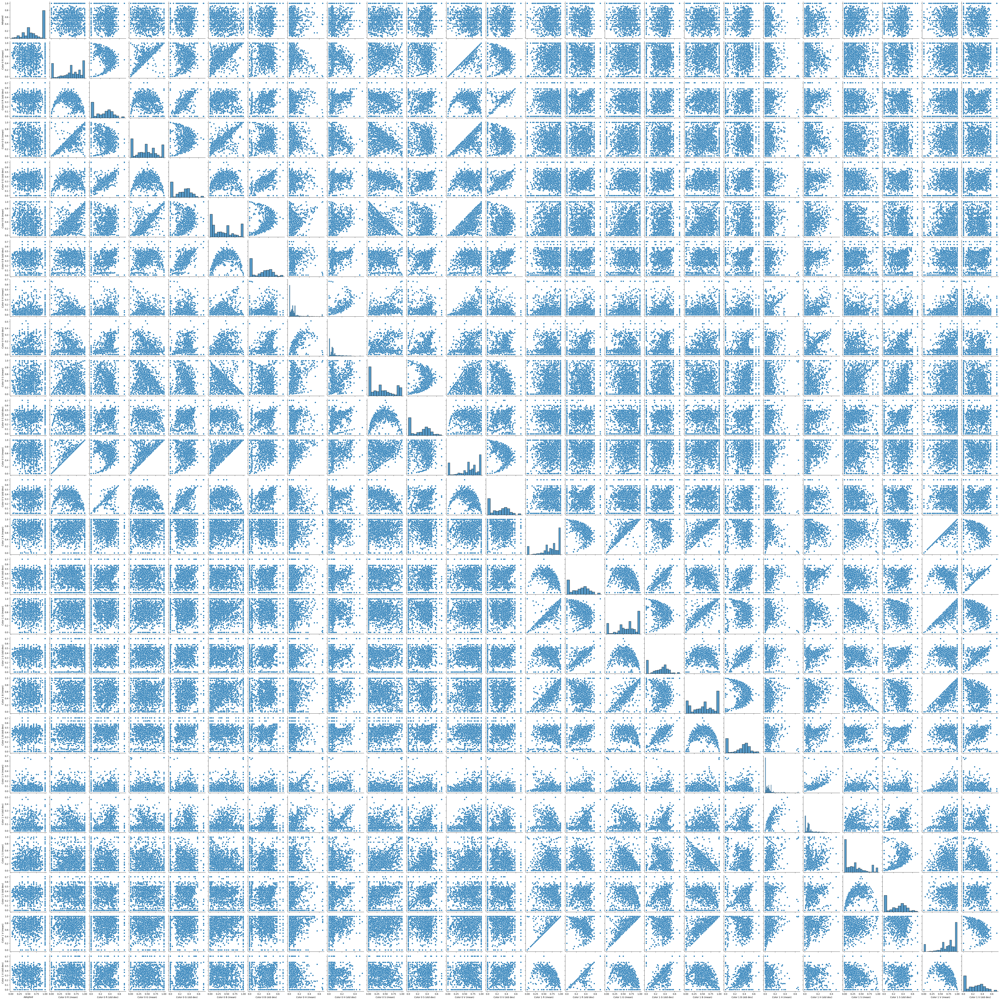

In [224]:
sns.pairplot(data=df_breeds)

In [225]:
# df_breeds_not_dogs_or_cats = df_breeds.loc[
#     (df_breeds['Animal Type'] != 'Dog') &
#     (df_breeds['Animal Type'] != 'Cat')]
# sns.pairplot(data=df_breeds_not_dogs_or_cats)

In [226]:
df_breeds_info = pd.read_csv('dog breeds_enriched_20210503.csv').convert_dtypes(infer_objects=True)
df_breeds_info.info()
df_breeds_info.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 195 entries, 0 to 194
Data columns (total 14 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Breed               195 non-null    string 
 1   Breed Group AKC     195 non-null    string 
 2   Breed Group CKC     195 non-null    string 
 3   Breed Group UKC     195 non-null    string 
 4   CKC Subgroup        194 non-null    string 
 5   height_low_inches   195 non-null    Float64
 6   height_high_inches  195 non-null    Float64
 7   average height      195 non-null    Float64
 8   weight_low_lbs      195 non-null    Float64
 9   weight_high_lbs     195 non-null    Int64  
 10  average weight      195 non-null    Float64
 11  Lifespan Low        194 non-null    Int64  
 12  Lifespan High       194 non-null    Int64  
 13  average lifespan    195 non-null    Float64
dtypes: Float64(6), Int64(3), string(5)
memory usage: 23.2 KB


,Breed,Breed Group AKC,Breed Group CKC,Breed Group UKC,CKC Subgroup,height_low_inches,height_high_inches,average height,weight_low_lbs,weight_high_lbs,average weight,Lifespan Low,Lifespan High,average lifespan
0,Affenpinscher,Toy Group,Group 5: Pinschers and Schnauzers,Companion Dog,5-B: Small Pinschers and Schnauzers,9.0,12.0,10.5,8.0,12,10.0,12,15,13.5
1,Afghan Hound,Hound Group,Group 8: Sighthound Breeds,Sighthound & Pariah,8-B: Long Haired Sighthounds,25.0,27.0,26.0,50.0,60,55.0,12,15,13.5
2,Aidi,Not Recognized,Not Recognized,Guardian Dog,Not Recognized,20.0,24.5,22.25,50.0,55,52.5,12,13,12.5
3,Airedale Terrier,Terrier Group,Group 6: Terrier Breeds,Terrier,6-A: Large Terriers,22.0,24.0,23.0,45.0,45,45.0,11,14,12.5
4,Akbash Dog,Not Recognized,Group 9: Large Guardian Pastoral/Mountain Dogs,Guardian Dog,None,27.0,34.0,30.5,75.0,140,107.5,9,11,10.0


/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(widths, name="widths"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not in

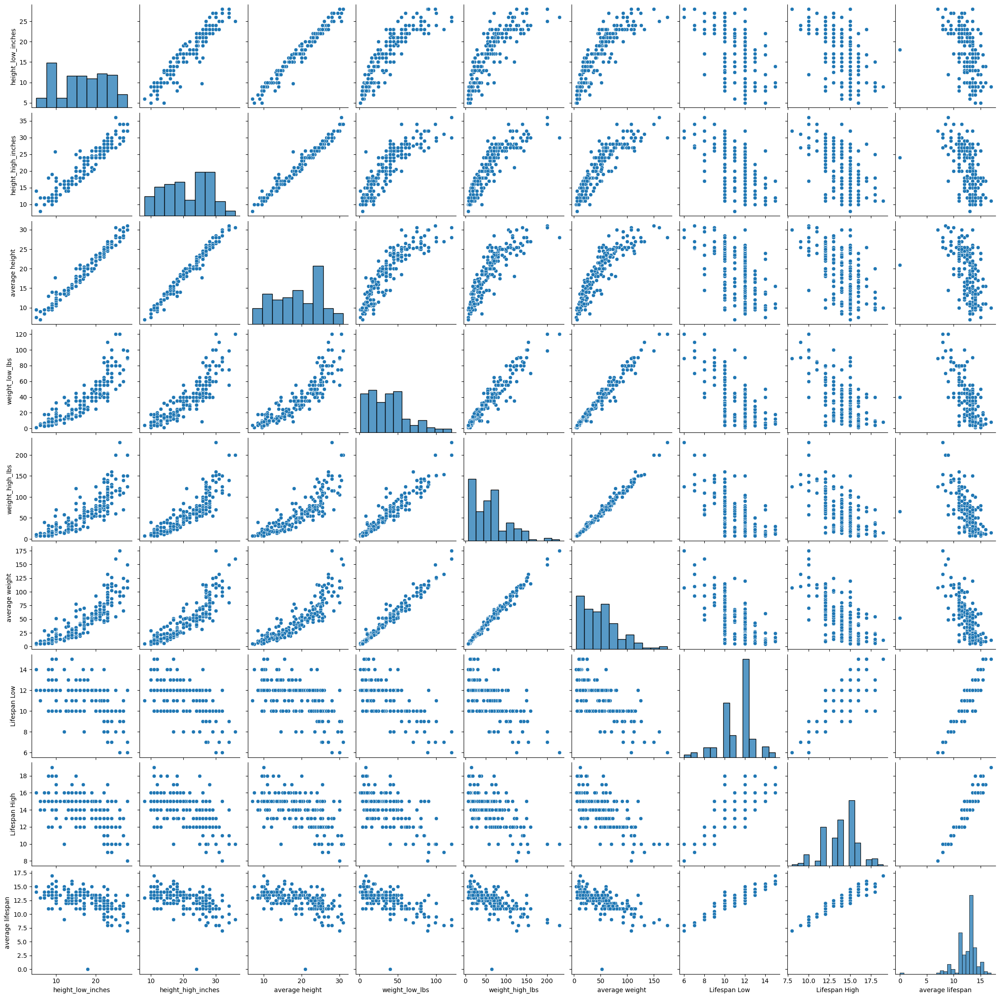

In [227]:
sns.pairplot(data=df_breeds_info)

In [228]:
df_breeds['Breed'] = df_breeds.index
df_breeds = df_breeds.merge(df_breeds_info, how='left', left_on='Breed', right_on='Breed').dropna()
df_breeds.info()
df_breeds.head()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 91 entries, 28 to 2350
Data columns (total 40 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Animal Type          91 non-null     string 
 1   Adopted              91 non-null     float64
 2   Color 0 R (mean)     91 non-null     Float64
 3   Color 0 R (std dev)  91 non-null     float64
 4   Color 0 G (mean)     91 non-null     Float64
 5   Color 0 G (std dev)  91 non-null     float64
 6   Color 0 B (mean)     91 non-null     Float64
 7   Color 0 B (std dev)  91 non-null     float64
 8   Color 0 H (mean)     91 non-null     Float64
 9   Color 0 H (std dev)  91 non-null     float64
 10  Color 0 S (mean)     91 non-null     Float64
 11  Color 0 S (std dev)  91 non-null     float64
 12  Color 0 V (mean)     91 non-null     Float64
 13  Color 0 V (std dev)  91 non-null     float64
 14  Color 1 R (mean)     91 non-null     Float64
 15  Color 1 R (std dev)  91 non-null     fl

,Animal Type,Adopted,Color 0 R (mean),Color 0 R (std dev),Color 0 G (mean),Color 0 G (std dev),Color 0 B (mean),Color 0 B (std dev),Color 0 H (mean),Color 0 H (std dev),...,CKC Subgroup,height_low_inches,height_high_inches,average height,weight_low_lbs,weight_high_lbs,average weight,Lifespan Low,Lifespan High,average lifespan
28,Dog,0.623894,0.449519,0.470024,0.30363,0.427486,0.54649,0.481388,0.207499,0.294873,...,10-C: Medium Pastoral Dogs,17.0,20.0,18.5,33.0,50,41.5,12,16,14.0
34,Dog,0.507266,0.444773,0.431108,0.358808,0.404615,0.196473,0.343267,0.049744,0.078679,...,11-C: Retrievers and Waterdogs,21.0,25.0,23.0,55.0,80,67.5,10,12,11.0
39,Dog,0.530435,0.705045,0.400066,0.662703,0.412465,0.656847,0.442782,0.066542,0.162848,...,4-A: Bulldogs,20.0,27.0,23.5,60.0,125,92.5,10,12,11.0
41,Dog,0.505376,0.509685,0.450212,0.39224,0.438852,0.35347,0.433338,0.061418,0.125268,...,2-D: Nordic Sled Dogs,19.0,24.0,21.5,35.0,60,47.5,12,14,13.0
51,Dog,0.406504,0.976288,0.101306,0.967535,0.131188,0.94,0.211495,0.012558,0.039391,...,9-A Large Mountain/Pastoral Dogs Shepherding Type,25.0,32.0,28.5,85.0,115,100.0,10,15,12.5


In [229]:
df_out_with_breeds_info = df_out.merge(df_breeds_info, how='left', left_on='Breed', right_on='Breed').dropna()
df_out_with_breeds_info.info()
df_out_with_breeds_info.head()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1731 entries, 157 to 149488
Data columns (total 45 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   Animal ID                 1731 non-null   string        
 1   Name                      1731 non-null   string        
 2   DateTime                  1731 non-null   datetime64[ns]
 3   MonthYear                 1731 non-null   string        
 4   Date of Birth             1731 non-null   datetime64[ns]
 5   Outcome Type              1731 non-null   string        
 6   Outcome Subtype           1731 non-null   string        
 7   Animal Type               1731 non-null   string        
 8   Sex upon Outcome          1731 non-null   string        
 9   Age upon Outcome          1731 non-null   string        
 10  Breed                     1731 non-null   string        
 11  Color                     1731 non-null   string        
 12  Colors (count)  

,Animal ID,Name,DateTime,MonthYear,Date of Birth,Outcome Type,Outcome Subtype,Animal Type,Sex upon Outcome,Age upon Outcome,...,CKC Subgroup,height_low_inches,height_high_inches,average height,weight_low_lbs,weight_high_lbs,average weight,Lifespan Low,Lifespan High,average lifespan
157,A783891,Elizabeth T,2019-01-16 11:28:00,Jan 2019,2015-11-08,Adoption,Foster,Dog,Spayed Female,3 years,...,6-B: Medium Terriers,11.0,16.0,13.5,11.0,16,13.5,12,15,13.5
253,A671609,Wilson,2015-07-02 11:04:00,Jul 2015,2013-01-28,Transfer,Partner,Dog,Neutered Male,2 years,...,11-C: Retrievers and Waterdogs,21.0,25.0,23.0,55.0,80,67.5,10,12,11.0
305,A875334,*Charles Barkley,2023-03-05 11:57:00,Mar 2023,2021-02-25,Transfer,Partner,Dog,Intact Male,2 years,...,4-A: Bulldogs,12.0,17.0,14.5,40.0,58,49.0,8,10,9.0
322,A836159,*Morgan,2021-06-30 14:41:00,Jun 2021,2019-12-07,Adoption,Foster,Dog,Spayed Female,1 year,...,10-C: Medium Pastoral Dogs,17.0,20.0,18.5,33.0,50,41.5,12,16,14.0
356,A827315,Atticus,2021-01-27 13:11:00,Jan 2021,2011-12-18,Adoption,Foster,Dog,Neutered Male,9 years,...,11-C: Retrievers and Waterdogs,21.0,25.0,23.0,55.0,80,67.5,10,12,11.0


In [230]:
df_out_with_breeds_info['Est. lifespan remaining'] = df_out_with_breeds_info['average lifespan'] - df_out_with_breeds_info['Age upon Outcome (years)']
df_out_with_breeds_info['Est. lifespan remaining'] = df_out_with_breeds_info['Est. lifespan remaining'].astype(dtype=float)
df_out_with_breeds_info['Est. lifespan remaining']

157       10.500000
253        9.000000
305        7.000000
322       13.000000
356        2.000000
            ...    
149433    12.000000
149451     9.000000
149464    12.000000
149475    13.666667
149488     2.000000
Name: Est. lifespan remaining, Length: 1731, dtype: float64

There isn't much correlation appearing yet

/tmp/ipykernel_7592/3730975783.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df_breeds_corr = df_breeds.corr()


Corr(Adopted, Color 0 B (mean)) ≈ -0.21480357794539656
Corr(Adopted, average height) ≈ 0.2286839421877296
Corr(Adopted, height_low_inches) ≈ 0.22650241073626362
Corr(Adopted, height_high_inches) ≈ 0.2265601870407705
Corr(Adopted, Lifespan Low) ≈ 0.16425096778945883


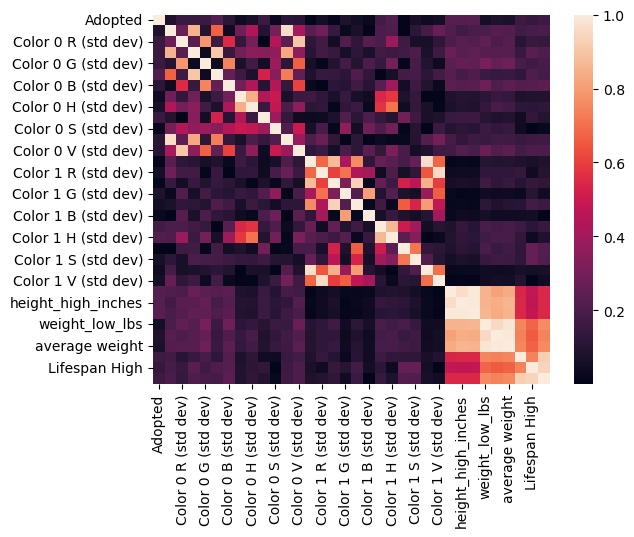

In [231]:
df_breeds_corr = df_breeds.corr()
sns.heatmap(data=df_breeds_corr.abs())

def score(df, var1, var2):
    print(f'Corr({var1}, {var2}) ≈ {df[var1][var2]}')

score(df_breeds_corr, 'Adopted', 'Color 0 B (mean)')
score(df_breeds_corr, 'Adopted', 'average height')
score(df_breeds_corr, 'Adopted', 'height_low_inches')
score(df_breeds_corr, 'Adopted', 'height_high_inches')
score(df_breeds_corr, 'Adopted', 'Lifespan Low')

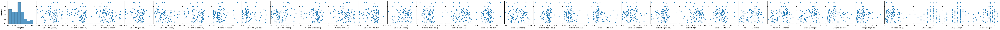

In [232]:
sns.pairplot(data=df_breeds, y_vars=['Adopted'])

## Height ~ adopted?

Is the average height of a breed correlated with its likelihood of being adopted? The Pearson correlation coefficient was Corr(Adopted, average height) ≈ 0.2286839421877296.

<AxesSubplot:xlabel='average height', ylabel='Adopted'>

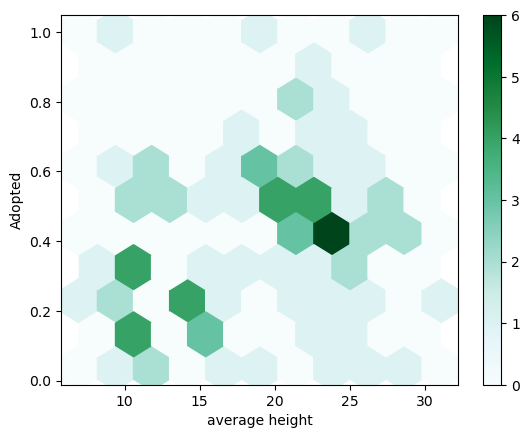

In [233]:
df_breeds.plot.hexbin(x='average height', y='Adopted', gridsize=10)

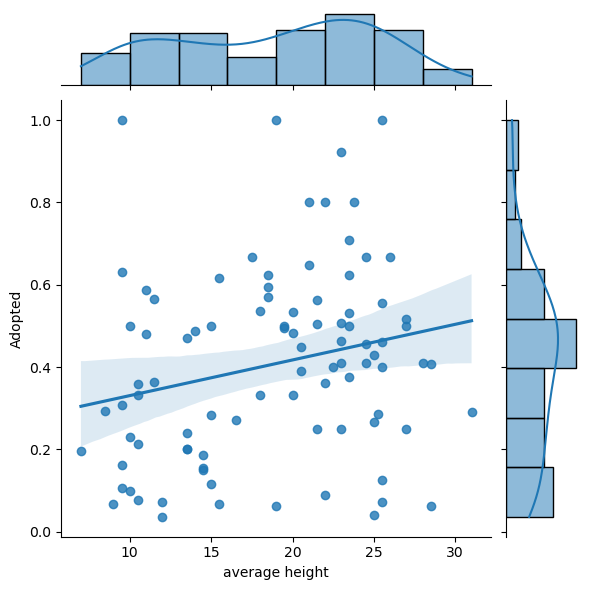

In [234]:
sns.jointplot(
    x=df_breeds['average height'].astype(dtype=float),
    y=df_breeds.Adopted.astype(dtype=float),
    kind='reg')

# Analysis by individuals

## Color

(results)

20


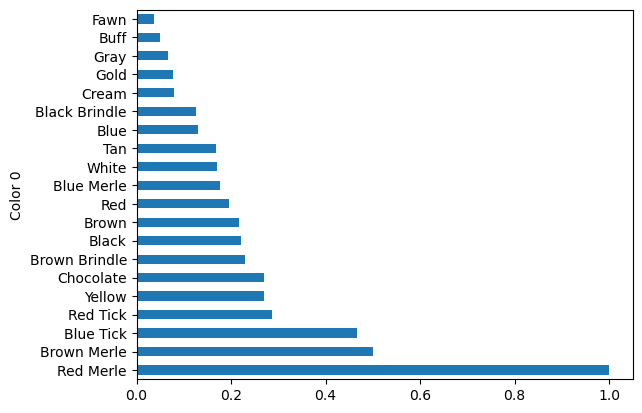

<AxesSubplot:xlabel='Count', ylabel='Color 0'>

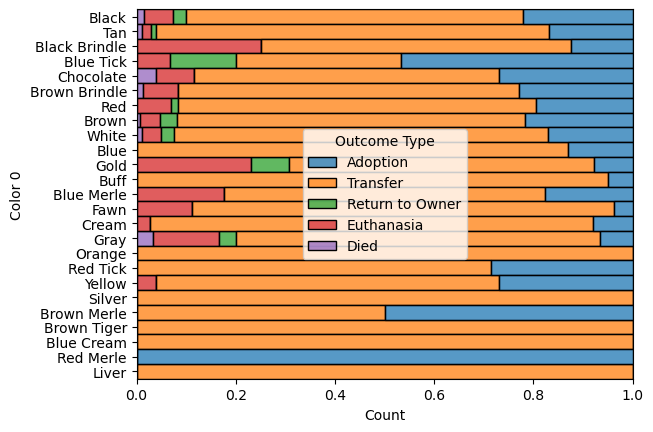

In [235]:
df_colors_adopted = bigCorr_categorical(df_out_with_breeds_info, 'Color 0', 'Adopted').sort_values(ascending=False)
print(len(df_colors_adopted))
df_colors_adopted.plot.barh()
plt.show()

df_out_with_breeds_info[['Outcome Type', 'Color 0']].groupby('Color 0')['Color 0']

df_colors_outcomes = df_out_with_breeds_info[['Outcome Type', 'Color 0']]

sns.histplot(
    data=df_colors_outcomes,
    y='Color 0',
    hue='Outcome Type',
    multiple='fill',
)

<AxesSubplot:xlabel='Color 0 S', ylabel='Color 0 V'>

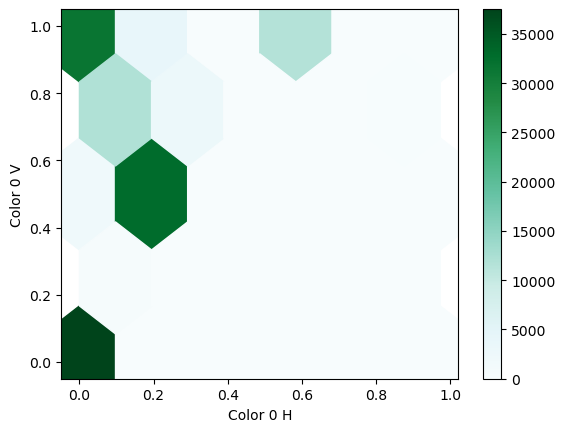

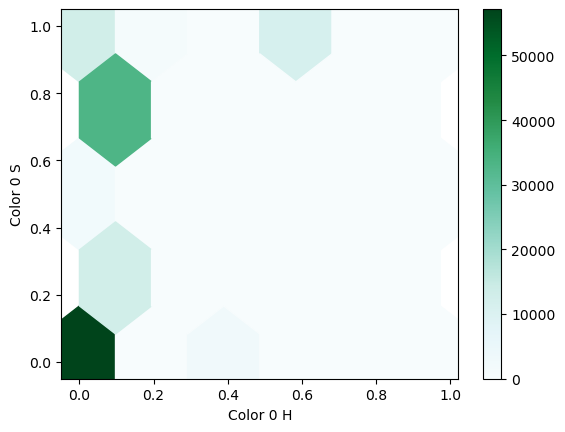

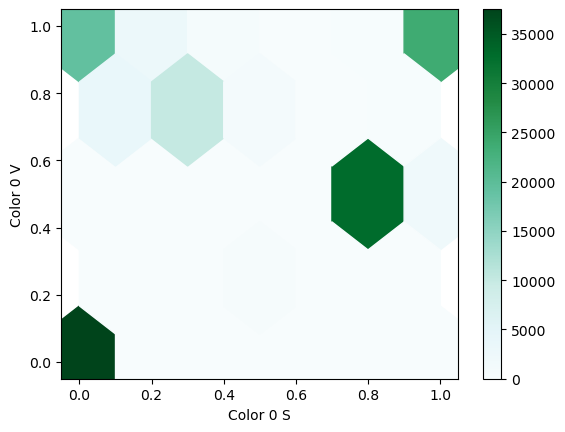

In [236]:
df_out.plot.hexbin(x='Color 0 H', y='Color 0 V', gridsize=5)
df_out.plot.hexbin(x='Color 0 H', y='Color 0 S', gridsize=5)
df_out.plot.hexbin(x='Color 0 S', y='Color 0 V', gridsize=5)

## Breed characteristics

This analysis considers individual animals and looks for correlations between characteristics of their breed and their outcome.

It looks like the animals belonging to a breed with an average height around 20-25 \(inches?\) are more likely to be adopted than others, and animals between 5-12 inches are less likely than others to be adopted.

**TODO:** interpret the other graphs. Why are the different lifespan variables distributed the way they are, and why are they distributed differently compared to each other?

average height ~ Adopted


/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(widths, name="widths"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not in

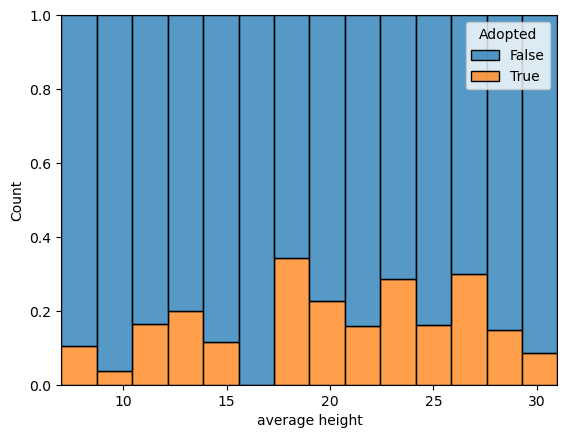

average height ~ Outcome Type


/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(widths, name="widths"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not in

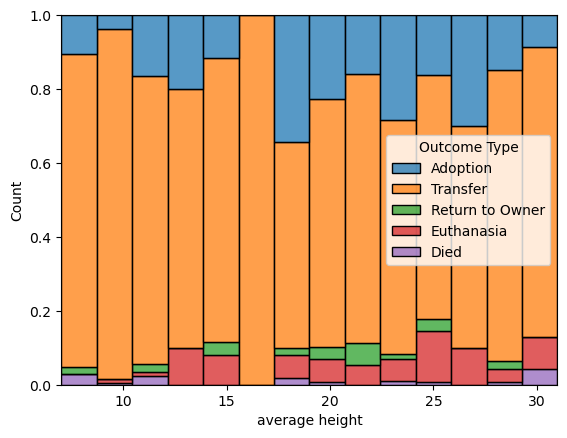

Est. lifespan remaining ~ Adopted


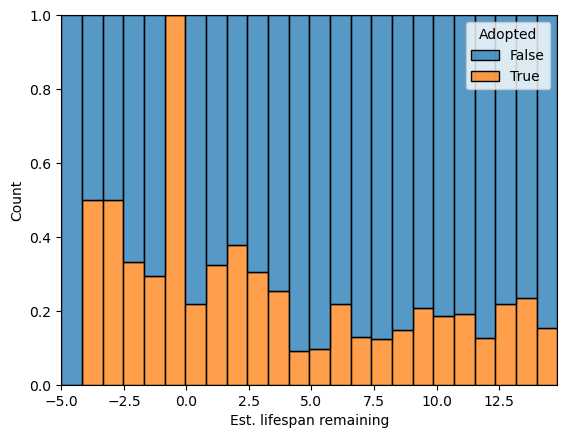

Est. lifespan remaining ~ Outcome Type


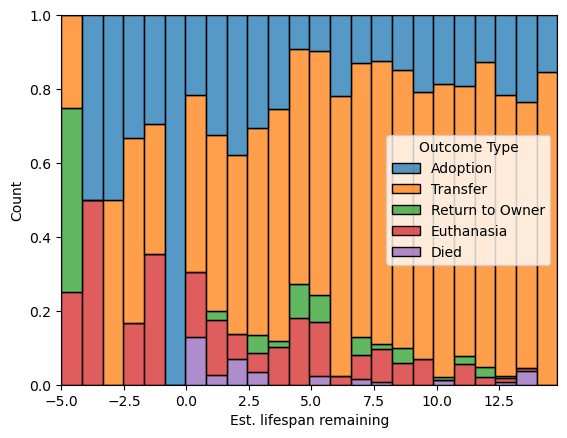

average lifespan ~ Adopted


/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(widths, name="widths"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not in

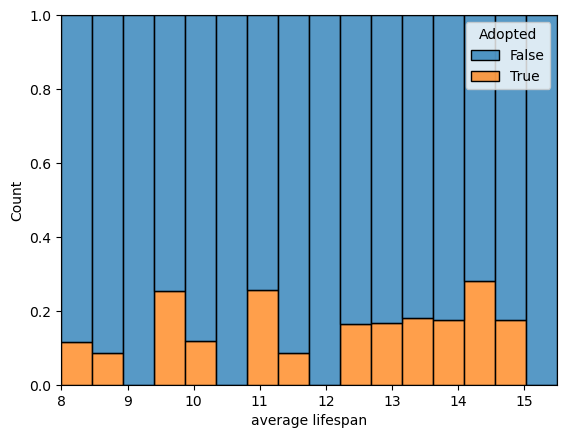

average lifespan ~ Outcome Type


/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(widths, name="widths"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not in

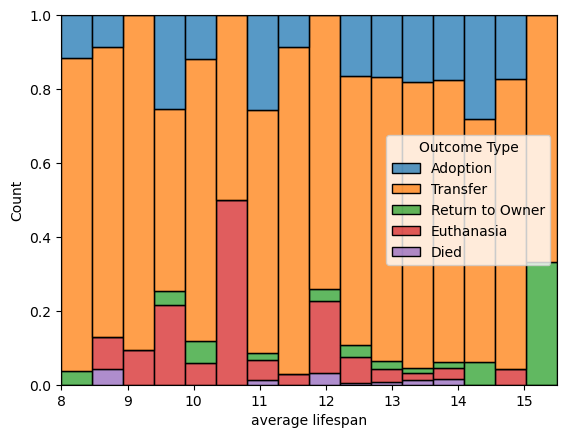

Lifespan Low ~ Adopted


/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(widths, name="widths"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not in

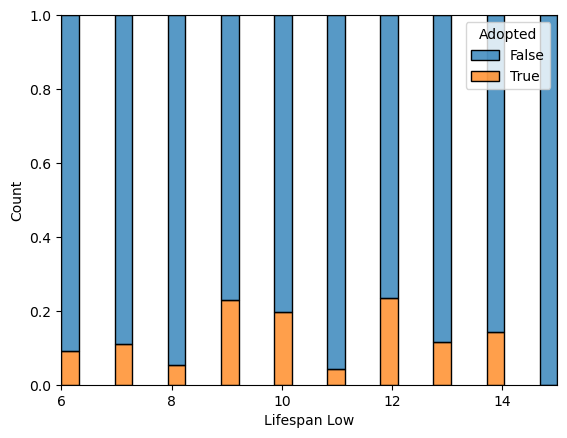

Lifespan Low ~ Outcome Type


/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(widths, name="widths"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not in

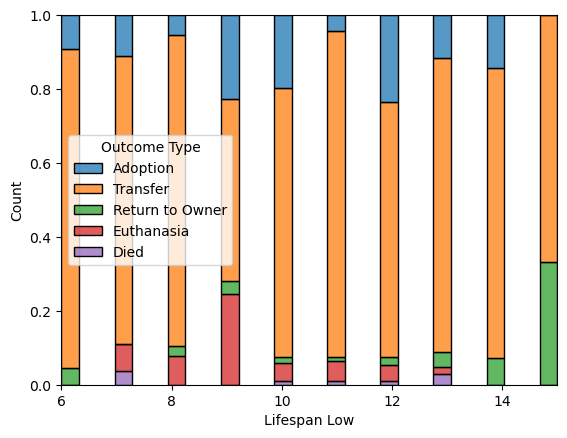

Lifespan High ~ Adopted


/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(widths, name="widths"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not in

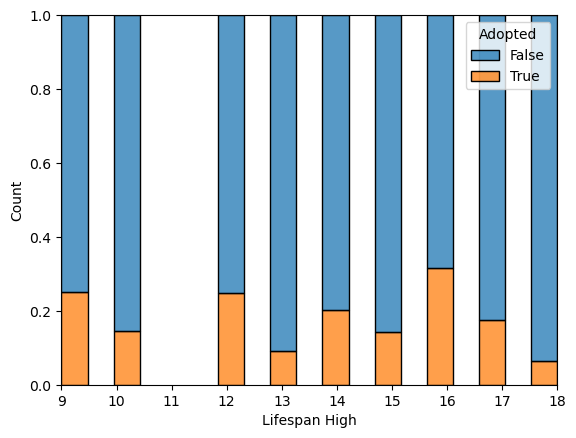

Lifespan High ~ Outcome Type


/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(widths, name="widths"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not in

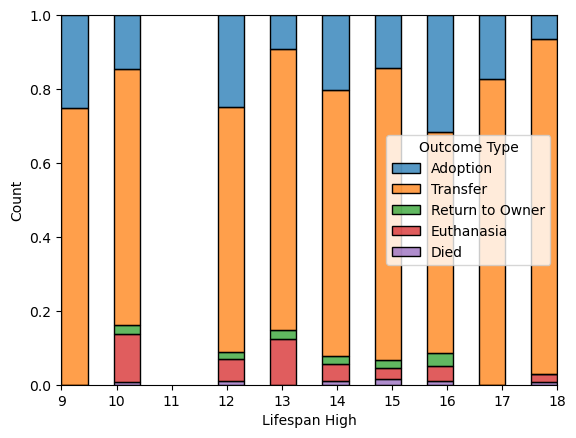

Color 0 H ~ Adopted


/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(widths, name="widths"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not in

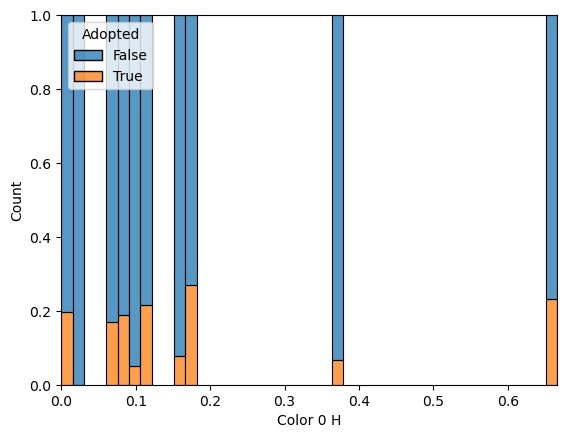

Color 0 H ~ Outcome Type


/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(widths, name="widths"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not in

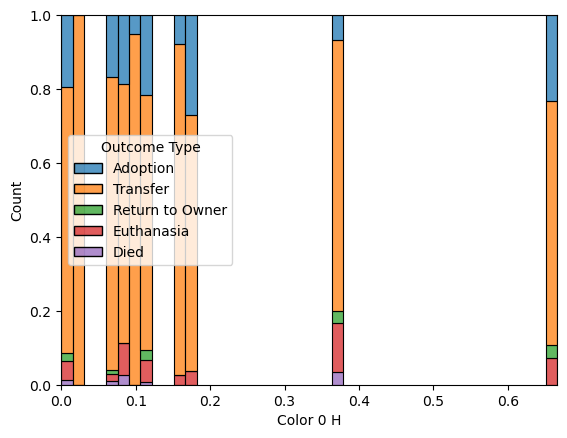

Color 0 S ~ Adopted


/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(widths, name="widths"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not in

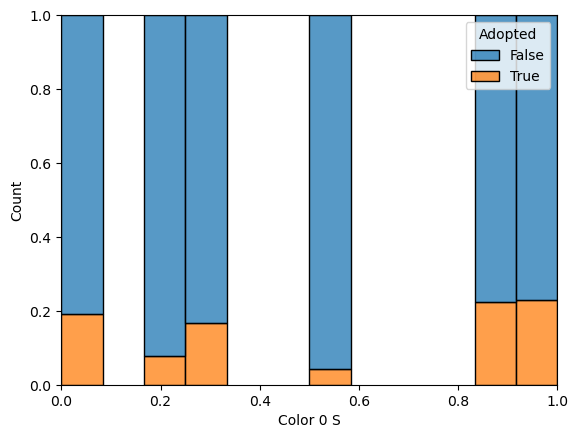

Color 0 S ~ Outcome Type


/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(widths, name="widths"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not in

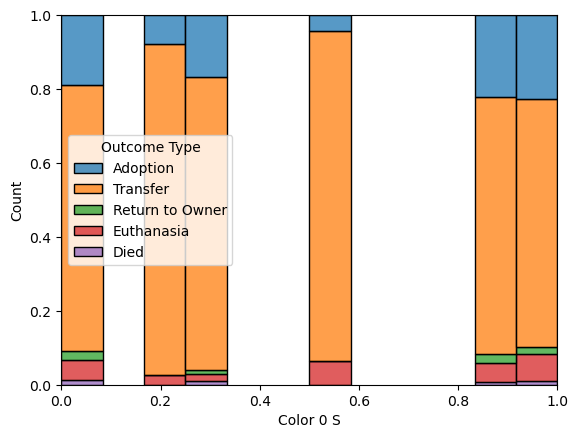

Color 0 V ~ Adopted


/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(widths, name="widths"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not in

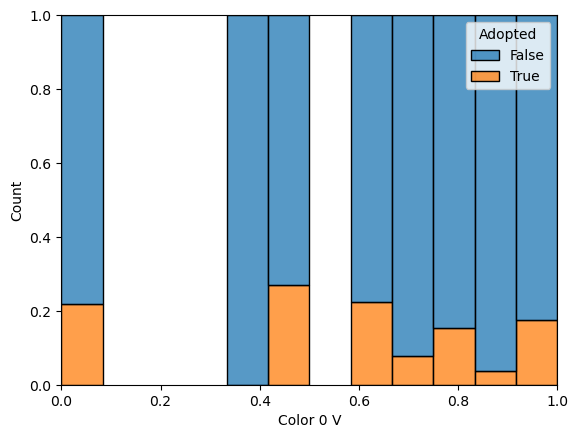

Color 0 V ~ Outcome Type


/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(widths, name="widths"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
/home/isaac/miniconda3/envs/cse3380/lib/python3.10/site-packages/seaborn/distributions.py:500: FutureWarning: In a future version, the Index constructor will not in

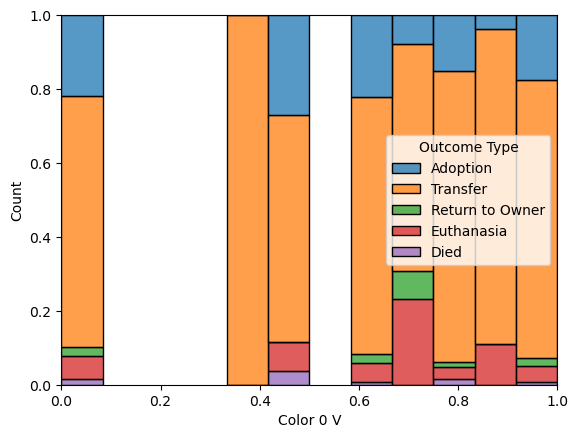

In [240]:
def kde(df, independent, dependent):
    print(f'{independent} ~ {dependent}')
    sns.histplot(data=df,
             x=independent,
             hue=dependent,
             multiple='fill')
    # df[[dependent, independent]].groupby(dependent)[independent].plot.kde(legend=True)
    plt.show()
    
independent_vars = [
    'average height',
    'Est. lifespan remaining',
    'average lifespan',
    'Lifespan Low',
    'Lifespan High',
    'Color 0 H',
    'Color 0 S',
    'Color 0 V'
]

for independent in independent_vars:
    for dependent in ['Adopted', 'Outcome Type']:
        kde(df_out_with_breeds_info, independent, dependent)

## Name

This section will attempt to look for correlations between the name of animals and their outcome.

In [238]:
# %pip install tensorflow
# %pip install tensorflow_hub

# # NOTE: when I ran this, it said:
# # "Note: you may need to restart the kernel to use updated packages."

In [239]:
# # adapted from TensorFlow tutorial
# # https://www.tensorflow.org/hub/tutorials/semantic_similarity_with_tf_hub_universal_encoder

# import tensorflow as tf
# import tensorflow_hub as hub
# import os
# import re

# module_url = "https://tfhub.dev/google/universal-sentence-encoder/4"
# model = hub.load(module_url)
# print ("module %s loaded" % module_url)
# def embed(input):
#   return model(input)